# Import file

In [1]:
# read file
from Bio import SeqIO

file1 = SeqIO.read('ex1.fasta', 'fasta')
file2 = SeqIO.read('ex2.fasta', 'fasta')

#kalo fasta ya fasta. genbank ya genbank.

In [2]:
# read sequence

seq1 = file1.seq
seq2 = file2.seq

print(seq1)
print(seq2)

TTAACCCTAGAAAGATAGTCTGCGTAAAATTGACGCATGCATTCTTGAAATATTGCTCTCTCTTTCTAAATAGCGCGAATCCGTCGCTGTGCATTTAGGACATCTCAGTCGCCGCTTGGAGCTCCCGTGAGGCGTGCTTGTCAATGCGGTAAGTGTCACTGATTTTGAACTATAACGACCGCGTGAGTCAAAATGACGCATGATTATCTTTTACGTGACTTTTAAGATTTAACTCATACGATAATTATATTGTTATTTCATGTTCTACTTACGTGATAACTTATTATATATATATTTTCTTGTTATAGATATCATCAACTTTGTATAGAAAAGTTGCTCGACATTGATTATTGACTAGTTATTAATAGTAATCAATTACGGGGTCATTAGTTCATAGCCCATATATGGAGTTCCGCGTTACATAACTTACGGTAAATGGCCCGCCTGGCTGACCGCCCAACGACCCCCGCCCATTGACGTCAATAATGACGTATGTTCCCATAGTAACGCCAATAGGGACTTTCCATTGACGTCAATGGGTGGAGTATTTACGGTAAACTGCCCACTTGGCAGTACATCAAGTGTATCATATGCCAAGTACGCCCCCTATTGACGTCAATGACGGTAAATGGCCCGCCTGGCATTATGCCCAGTACATGACCTTATGGGACTTTCCTACTTGGCAGTACATCTACGTATTAGTCATCGCTATTACCATGGTCGAGGTGAGCCCCACGTTCTGCTTCACTCTCCCCATCTCCCCCCCCTCCCCACCCCCAATTTTGTATTTATTTATTTTTTAATTATTTTGTGCAGCGATGGGGGCGGGGGGGGGGGGGGGGCGCGCGCCAGGCGGGGCGGGGCGGGGCGAGGGGCGGGGCGGGGCGAGGCGGAGAGGTGCGGCGGCAGCCAATCAGAGCGGCGCGCTCCGAAAGTTTCCTTTTATGGCGAGGCGGCGGCGGCGGCGGCCCTATAAAAAGCGAAGCGCGCGGCGGGCGGG

# Sequence manipulation using python

In [6]:
# length
print(len(seq1))
print(len(seq2))

# find 
print(seq1.find('ACG'))
print(seq2.find('ACGTA'))
# find when nucleotide TCG appear from the right!
print(seq1.rfind('TCG'))

# reverse and slicing [start:end:step]
seq1reversed = seq1[::-1]
seq1firstfive = seq1[:5]
seq1lastseven = seq1[-7:]

# combine
temp = seq1[:7] + seq2[-3:]
seq3 = temp[::-1]
print(seq3)

4347
7770
32
136
4257
ACCCCCAATT


# Sequence analysis

In [7]:
# Melting Temp
from Bio.SeqUtils import MeltingTemp
# Wallace
print(MeltingTemp.Tm_Wallace(seq1))
# NN
print(MeltingTemp.Tm_NN(seq2))
# GC Content
print(MeltingTemp.Tm_GC(seq3))

13578.0
84.27472091053113
20.40290207197791


# GC AT Content

In [10]:
from Bio.SeqUtils import GC

print(GC(seq1))
print(100-GC(seq1))

ImportError: cannot import name 'GC' from 'Bio.SeqUtils' (g:\Computational Biology Lab Semester 4\env\environments\computational_biology\Lib\site-packages\Bio\SeqUtils\__init__.py)

# Molecular Weight

In [23]:
from Bio.SeqUtils import molecular_weight

print(molecular_weight(seq1))

2404833.5803


# Base Frequency

In [ ]:
from collections import Counter
print(Counter(seq1))

Counter({'G': 2120, 'C': 1942, 'A': 1926, 'T': 1782})


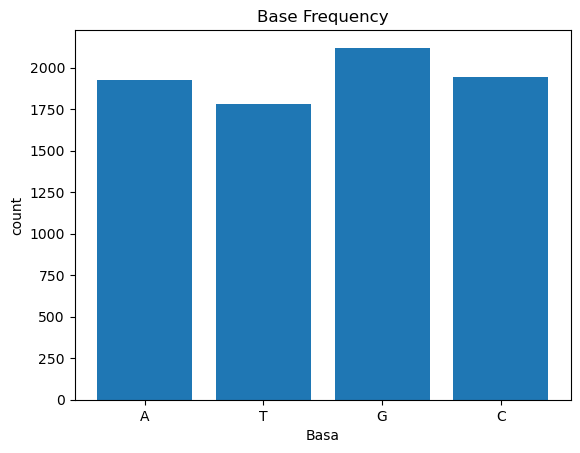

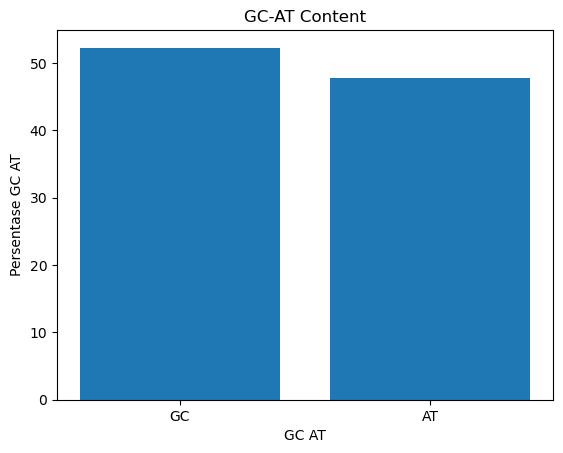

In [30]:
import matplotlib.pyplot as plt

plt.bar(Counter(seq1).keys(), Counter(seq1).values())
plt.title('Base Frequency')
plt.xlabel('Basa')
plt.ylabel('count')
plt.show()

plt.bar(['GC', 'AT'], [GC(seq1), 100-GC(seq1)])
plt.title('GC-AT Content')
plt.xlabel('GC AT')
plt.ylabel('Persentase GC AT')
plt.show()

# DNA and mRNA protein synthesis

In [ ]:
mrna = seq2.transcribe()
print(mrna)

protein = mrna.translate()
print(protein)

TACCTCTCTGGCTTCTGCCATGCCCTCGAACGCTTCTAAAATGTCCAGGGTATGGTGCTGCAGGACGATGCGACATAGAAAACGTTTCTGAAGGACTCACTTAATCTAAACTTACGCAAGCTAATATCTGTCAACGTGCATTAAACCTCCGGTCTGCCGCACGTACCCCGTACGGTCCGAACACATCCTGAACATCGCATATTCCTAAACAACTTCTTATGTCTCACGTGCAACCTCCGACTGCCCCAACTCGTCAAGCTCTCTGCAGGAGACTCCCTGTAACGACAGTCCACACGGCCGACGGAATTTGGAAACCTGATAGATCTCTTCAATCTCACGATATGCCTCGCGTGTGGCAAAACCGCACATTCCCTGGAAACCTCCCCTGCGACGTCTTTGACGACTCTTTCGTACTAACCCTTTGTCGGATGTTAATCCCTACACCTCGACCAGAATGTGCTGGACAGCGGTGGTCTACACCTCGGTGGACACCCAAGTCTCCGCCTCAGTTGGGTCACCGGAATATCTTATTGCTGCATAACAGTGCCGACGTTAGTCTTCGAAGCCAACCAACATCACCGGCCCCTACGGCGACACGACTTGAAGCTCGTCAACGACGAACTCCCAGACTTGGATGACACGGGACTGACGAGGTCCGTCAACTCGAAACCTTTACCGTCTGCTATTTCCATGTCTCACGAGACTTAGGGATCTTCCGACATCACTTACCAAAAACCTACGACTCCGACTCACACTCCTACCGAACCTAAGGGACCTTTCCGACAAACTTCTGTCGTGCCTACCGAGTTATTAAAGACTAGAGTAACTGCTACCCCTCACGTTAGTCCCTTTATGGGACCGTGACAAATTGTTTGTCGACAATGTCCTGTTACTCGTCGTACACCCTCTTAATTTTGCTTTCATACAAAGCGGCTCAGGGTTTGTGAGCCACGAGCTGGAGTCAGGATTCGACGTCAGGCACAGAGACAGAGGCGTTTTT

# Sequence alignment and similarities

In [40]:
# hamming
def hamming(x, y):
    score = 0
    for i, j in zip(x, y):
        if i!=j:
            score = score + 1
    return score

print(hamming(seq1, seq2))

# levenshtein
from Levenshtein import distance
print(distance(seq1, seq2))

# dotplot
def dotplot(x, y):
    print(f' |{y}')
    print('-------------------')
    for i in x:
        print(f'{i}|', end="")
        for j in y:
            if i == j:
                print('X', end="")
            else:
                print(' ', end = '')
        print('')
        
dotplot(seq3, seq3)

0
0
 |ACCAGAGGTA
-------------------
A|X  X X   X
C| XX       
C| XX       
A|X  X X   X
G|    X XX  
A|X  X X   X
G|    X XX  
G|    X XX  
T|        X 
A|X  X X   X


# Alignment (local dan global)

In [45]:
from Bio import pairwise2
from Bio.pairwise2 import format_alignment

# Local alignment:
local_alignment = pairwise2.align.localxx(seq1, seq3)
# global alignment
global_alignment = pairwise2.align.globalxx(seq1, seq3)

for i in local_alignment:
    print(format_alignment(*i))
    
    
for j in global_alignment:
    print(format_alignment(*j))

7727 ACGGTTGCCTATAAATACATTGGAGACCCTTAACGGTGGCACCA
     |       |        |     ||       | |||      |
   1 A-------C--------C-----AG-------A-GGT------A
  Score=10

7726 AACGGTTGCCTATAAATACATTGGAGACCCTTAACGGTGGCACCA
     |        |        |     ||       | |||      |
   1 A--------C--------C-----AG-------A-GGT------A
  Score=10

7720 ACCGCTAACGGTTGCCTATAAATACATTGGAGACCCTTAACGGTGGCACCA
     |              |        |     ||       | |||      |
   1 A--------------C--------C-----AG-------A-GGT------A
  Score=10

7719 AACCGCTAACGGTTGCCTATAAATACATTGGAGACCCTTAACGGTGGCACCA
     |               |        |     ||       | |||      |
   1 A---------------C--------C-----AG-------A-GGT------A
  Score=10

7715 ACGTAACCGCTAACGGTTGCCTATAAATACATTGGAGACCCTTAACGGTGGCACCA
     |                   |        |     ||       | |||      |
   1 A-------------------C--------C-----AG-------A-GGT------A
  Score=10

7713 ACACGTAACCGCTAACGGTTGCCTATAAATACATTGGAGACCCTTAACGGTGGCACCA
     |                     |        |     